! kaggle competitions download -c tabular-playground-series-jan-2021
! mkdir input

! 7z e d:/git/intelligent-systems-practice/kaggle/tabular-playground-series-jan-2021.zip -od:/git/intelligent-systems-practice/kaggle/input

In [1]:
import numpy as np
import pandas as pd
import os
        
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

In [2]:
notebook_path = os.path.dirname(os.path.abspath("v2.ipynb"))+"\\"
input_path = notebook_path + 'input\\'
input_path

'd:\\git\\intelligent-systems-practice\\kaggle\\input\\'

In [3]:
train = pd.read_csv(input_path + 'train.csv', index_col='id')
test = pd.read_csv(input_path + 'test.csv', index_col='id')

In [4]:
train, X_test, y_train, y_test = train_test_split(train, train['target'], train_size=0.60)

In [5]:
X_test.drop(columns=['target'], inplace=True)

import matplotlib as mpl
mpl.rcParams['agg.path.chunksize'] = 10000

fig, axs = plt.subplots(2, 7)
i = 0
j = 0
for col in list(train.columns)[:-1]:
    if i < 2:
        if j < 7:
            axs[i, j].plot(train.index, train[col], 'o')
            axs[i, j].set_title(col)
            j += 1
        else:
            j = 0
            i += 1
            axs[i, j].plot(train.index, train[col], 'o')
            axs[i, j].set_title(col)
            j += 1
    else:
        break

In [6]:
for i in list(train.index):
    if train['cont1'][i] < 0.01 or train['cont2'][i] < 0.01 or train['cont3'][i] < 0.1 or train['cont7'][i] < 0.05 or train['cont10'][i] < 0.1 or train['cont10'][i] > 1.05 or train['cont9'][i] < -0.1:
        train.drop(i, inplace=True)

In [7]:
train.shape

(179280, 15)

fig, axs = plt.subplots(2, 7, figsize=(50, 15))
i = 0
j = 0
for col in list(train.columns)[:-1]:
    if i < 2:
        if j < 7:
            axs[i, j].plot(train.index, train[col], 'o')
            axs[i, j].set_title(col)
            j += 1
        else:
            j = 0
            i += 1
            axs[i, j].plot(train.index, train[col], 'o')
            axs[i, j].set_title(col)
            j += 1
    else:
        break

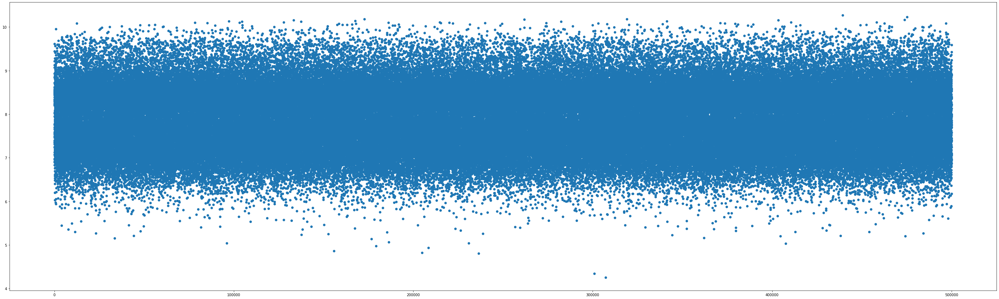

In [8]:
fig, ax = plt.subplots(figsize=(50, 15))
ax.plot(train.index, train['target'], 'o')

In [9]:
for i in list(train.index):
    if train['target'][i] < 5.5 or train['target'][i] > 10:
        train.drop(i, inplace=True)

In [10]:
train.shape

(179129, 15)

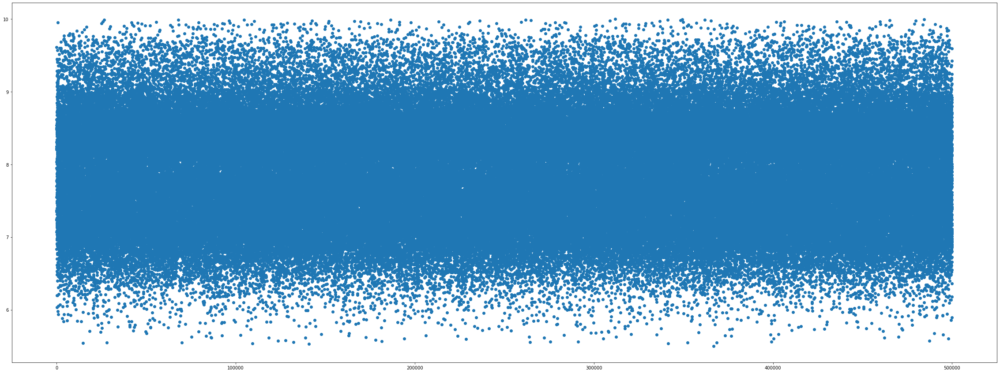

In [11]:
fig, ax = plt.subplots(figsize=(40, 15))
ax.plot(train.index, train['target'], 'o')

In [12]:
y_train = train.pop("target")
X_train = train

In [13]:
import xgboost as xgb

In [14]:
xg_reg = xgb.XGBRegressor(objective ='reg:squarederror')
xg_reg.fit(X_train, y_train)
preds = xg_reg.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("RMSE: %f" % (rmse))

RMSE: 0.706686


In [15]:
xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', reg_alpha=0.8)
xg_reg.fit(X_train, y_train)
preds = xg_reg.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("RMSE: %f" % (rmse))

RMSE: 0.705260


In [16]:
xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', reg_alpha=0.8, booster='dart')
xg_reg.fit(X_train, y_train)
preds = xg_reg.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("RMSE: %f" % (rmse))

RMSE: 0.705727


In [17]:
xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', reg_alpha=0.8, booster='dart', eta = 0.2, eval_metric = 'rmse')
xg_reg.fit(X_train, y_train)
preds = xg_reg.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("RMSE: %f" % (rmse))

RMSE: 0.704254


In [18]:
xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', reg_alpha=0.95, booster='dart', eta = 0.2, eval_metric = 'rmse')
xg_reg.fit(X_train, y_train)
preds = xg_reg.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("RMSE: %f" % (rmse))

RMSE: 0.703954


In [19]:
xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', reg_alpha=0.94, booster='dart', eta = 0.2, eval_metric = 'rmse', tree_method='hist')
xg_reg.fit(X_train, y_train)
preds = xg_reg.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("RMSE: %f" % (rmse))

RMSE: 0.703709


In [20]:
from sklearn.model_selection import learning_curve
from sklearn.model_selection import validation_curve

In [22]:
params_xgb = {'lambda': 1,
 'alpha': 0,
 'colsample_bytree': 1,
 'subsample': 1,
 'learning_rate': 0.05,
 'max_depth': 6,
 'min_child_weight': 3,
 'random_state': 48}

In [24]:
model_xgb = xgb.XGBRegressor(**params_xgb)
model_xgb.fit(X_train, y_train)
preds = model_xgb.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("RMSE: %f" % (rmse))

RMSE: 0.710007


In [25]:
params_xgb = {'lambda': 0.1,
 'alpha': 0.95,
 'colsample_bytree': 1,
 'subsample': 1,
 'learning_rate': 0.0005,
 'max_depth': 11,
 'min_child_weight': 1,
 'objective': 'reg:squarederror',
 'booster': 'dart',
 'eta': 0.05,
 'eval_metric': 'rmse',
 'tree_method': 'hist'}
model_xgb = xgb.XGBRegressor(**params_xgb)

In [26]:
model_xgb.fit(X_train, y_train)
preds = model_xgb.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("RMSE: %f" % (rmse))

RMSE: 7.082120


In [27]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import export_graphviz
import pydot

In [28]:
regr = RandomForestRegressor(criterion='mse', max_depth=5, max_features='sqrt', oob_score=True)
regr.fit(X_train, y_train)
preds = regr.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("RMSE: %f" % (rmse))

RMSE: 0.721184


In [31]:
regr = RandomForestRegressor(n_estimators = 500, max_depth=15, criterion='mse', min_samples_split=500, max_features='sqrt')
regr.fit(X_train, y_train)
preds = regr.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("RMSE: %f" % (rmse))

RMSE: 0.710250


In [32]:
tree = regr.estimators_[5]
export_graphviz(tree, out_file = 'tree1.dot', feature_names = list(X_train.columns), rounded = True, precision = 1)
(graph, ) = pydot.graph_from_dot_file('tree1.dot')
graph.write_png('tree1.png')

xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', reg_alpha=0.94, booster='dart', eta = 0.2, eval_metric = 'rmse', tree_method='hist')
xg_reg.fit(X_train, y_train)
preds = xg_reg.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("RMSE: %f" % (rmse))
preds = xg_reg.predict(test)
my_df = pd.DataFrame(list(test.index), columns=['id'])
my_df['target'] = preds
my_df.to_csv('sub.csv', index=False)